## Librairies & Imports

In [1]:
import os
import cv2
import json
import random
import numpy as np
from glob import glob
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split

In [2]:
import tensorflow as tf
import tensorflow.keras.backend as K
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, Conv2DTranspose, concatenate, Dropout

## Data

In [3]:
# --- 1. RENSEIGNE TES INFOS ICI ---
# Ton pseudo Kaggle (regarde ton profil si tu as un doute)
KAGGLE_USERNAME = "victorjcb"
# La clé que tu as dans ton presse-papier
KAGGLE_KEY = "KGAT_d18f06906256a47053975d8db22bec04"

# --- 2. CRÉATION AUTOMATIQUE DU FICHIER ---
token = {"username": KAGGLE_USERNAME, "key": KAGGLE_KEY}

with open('kaggle.json', 'w') as file:
    json.dump(token, file)

print("✅ Fichier kaggle.json créé avec succès !")

# --- 3. CONFIGURATION DES DROITS & TÉLÉCHARGEMENT ---
!pip install -q kaggle
!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/
!chmod 600 ~/.kaggle/kaggle.json

# --- 4. TÉLÉCHARGEMENT DU DATASET BRISC ---
print("Téléchargement du dataset BRISC...")
# On force le re-téléchargement si nécessaire
!kaggle datasets download -d briscdataset/brisc2025 --force

print("Décompression...")
!unzip -q brisc2025.zip -d brisc_data
print("🚀 Dataset prêt dans le dossier 'brisc_data'")

✅ Fichier kaggle.json créé avec succès !
Téléchargement du dataset BRISC...
Dataset URL: https://www.kaggle.com/datasets/briscdataset/brisc2025
License(s): Attribution 4.0 International (CC BY 4.0)
 80%|████████████████████████████████▏       | 201M/250M [00:00<00:00, 1.10GB/s]
100%|████████████████████████████████████████| 250M/250M [00:00<00:00, 1.10GB/s]
Décompression...
🚀 Dataset prêt dans le dossier 'brisc_data'


In [4]:
# --- CONFIGURATION ---
IMG_SIZE = 256
BATCH_SIZE = 32
# Chemin où tu as dézippé les données (d'après la commande précédente)
DATA_ROOT = "brisc_data"

class BriscDataGenerator(tf.keras.utils.Sequence):
    def __init__(self, image_paths, mask_dir, batch_size=32, img_size=256, shuffle=True):
        self.image_paths = image_paths
        self.mask_dir = mask_dir
        self.batch_size = batch_size
        self.img_size = img_size
        self.shuffle = shuffle
        self.indices = np.arange(len(self.image_paths))

        # Ton CLAHE Agressif
        self.clahe = cv2.createCLAHE(clipLimit=4.0, tileGridSize=(8,8))
        self.on_epoch_end()

    def __len__(self):
        return int(np.floor(len(self.image_paths) / self.batch_size))

    def __getitem__(self, index):
        indexes = self.indices[index*self.batch_size:(index+1)*self.batch_size]

        X = np.zeros((self.batch_size, self.img_size, self.img_size, 3), dtype=np.float32)
        y = np.zeros((self.batch_size, self.img_size, self.img_size, 1), dtype=np.float32)

        for i, idx in enumerate(indexes):
            img_path = self.image_paths[idx]

            # --- 1. Image (JPG) + CLAHE ---
            img = cv2.imread(img_path)
            if img is not None:
                # BGR -> LAB -> CLAHE -> BGR
                lab = cv2.cvtColor(img, cv2.COLOR_BGR2LAB)
                l, a, b = cv2.split(lab)
                l2 = self.clahe.apply(l)
                img = cv2.cvtColor(cv2.merge((l2, a, b)), cv2.COLOR_LAB2BGR)

                img = cv2.resize(img, (self.img_size, self.img_size))
                img = img / 255.0
                X[i] = img

            # --- 2. Masque (PNG) ---
            # On assume que le masque a le même nom mais en .png (logique BRISC standard)
            filename = os.path.basename(img_path)
            name_no_ext = os.path.splitext(filename)[0]
            mask_name = name_no_ext + ".png"
            mask_path = os.path.join(self.mask_dir, mask_name)

            mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)
            if mask is not None:
                mask = cv2.resize(mask, (self.img_size, self.img_size))
                mask = mask / 255.0
                mask = (mask > 0.5).astype(np.float32)
                y[i] = np.expand_dims(mask, axis=-1)

        return X, y

    def on_epoch_end(self):
        if self.shuffle:
            np.random.shuffle(self.indices)

# --- PRÉPARATION DES LISTES ---
# Adaptation des chemins selon la structure dézippée
# On cherche récursivement car parfois l'unzip crée des sous-dossiers
search_path_img = os.path.join(DATA_ROOT, "**", "train", "images", "*.jpg")
all_image_paths = sorted(glob(search_path_img, recursive=True))

if not all_image_paths:
    print("⚠️ ATTENTION : Aucune image trouvée ! Vérifie le chemin 'DATA_ROOT'.")
else:
    # On déduit le dossier des masques à partir du dossier de la première image trouvée
    first_img_dir = os.path.dirname(all_image_paths[0])
    # On suppose que le dossier 'masks' est au même niveau que 'images'
    train_mask_dir = os.path.join(os.path.dirname(first_img_dir), "masks")

    print(f"📂 Dossier Images : {first_img_dir}")
    print(f"📂 Dossier Masques : {train_mask_dir}")

    # Split Train (80%) / Val (20%)
    train_paths, val_paths = train_test_split(all_image_paths, test_size=0.2, random_state=42)

    print(f"✅ Images d'entraînement : {len(train_paths)}")
    print(f"✅ Images de validation  : {len(val_paths)}")

    # Création des instances
    train_gen = BriscDataGenerator(train_paths, train_mask_dir, batch_size=BATCH_SIZE, img_size=IMG_SIZE)
    val_gen = BriscDataGenerator(val_paths, train_mask_dir, batch_size=BATCH_SIZE, img_size=IMG_SIZE)

📂 Dossier Images : brisc_data/brisc2025/segmentation_task/train/images
📂 Dossier Masques : brisc_data/brisc2025/segmentation_task/train/masks
✅ Images d'entraînement : 3146
✅ Images de validation  : 787


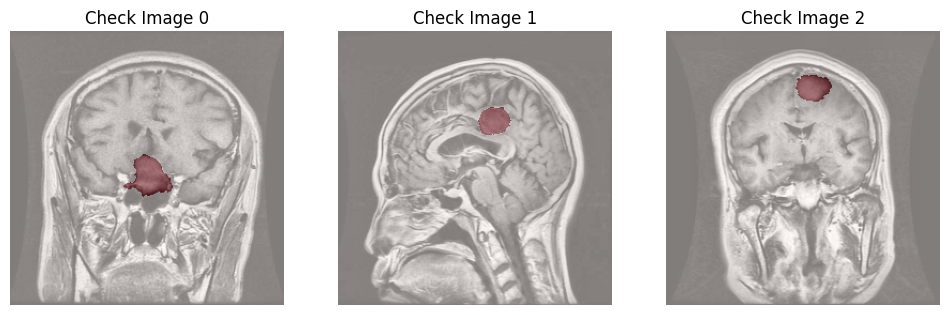

In [5]:
# On tire un batch du générateur de validation
X_batch, y_batch = val_gen[0]

plt.figure(figsize=(12, 4))
for i in range(3): # On regarde les 3 premières images
    plt.subplot(1, 3, i+1)
    # Image en fond
    plt.imshow(X_batch[i][..., ::-1]) # BGR -> RGB
    # Masque en surimpression rouge
    plt.imshow(y_batch[i].squeeze(), cmap='Reds', alpha=0.5)
    plt.title(f"Check Image {i}")
    plt.axis('off')
plt.show()

## Entraînement architecture U-Net sur jpg

In [9]:
# --- MÉTRIQUES ---
def dice_coef(y_true, y_pred):
    y_true_f = K.flatten(y_true)
    y_pred_f = K.flatten(y_pred)
    intersection = K.sum(y_true_f * y_pred_f)
    return (2. * intersection + 1) / (K.sum(y_true_f) + K.sum(y_pred_f) + 1)

def dice_coef_loss(y_true, y_pred):
    return 1 - dice_coef(y_true, y_pred)

# --- MODÈLE U-NET OPTIMISÉ (~1.4M params) ---
def simple_unet_model(IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS):
    inputs = Input((IMG_HEIGHT, IMG_WIDTH, IMG_CHANNELS))
    s = inputs

    # N1
    c1 = Conv2D(16, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(s); c1 = Dropout(0.1)(c1)
    c1 = Conv2D(16, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c1); p1 = MaxPooling2D((2, 2))(c1)
    # N2
    c2 = Conv2D(32, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p1); c2 = Dropout(0.1)(c2)
    c2 = Conv2D(32, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c2); p2 = MaxPooling2D((2, 2))(c2)
    # N3
    c3 = Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p2); c3 = Dropout(0.2)(c3)
    c3 = Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c3); p3 = MaxPooling2D((2, 2))(c3)
    # N4
    c4 = Conv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p3); c4 = Dropout(0.2)(c4)
    c4 = Conv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c4); p4 = MaxPooling2D(pool_size=(2, 2))(c4)

    # Bottleneck (160)
    c5 = Conv2D(160, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(p4); c5 = Dropout(0.3)(c5)
    c5 = Conv2D(160, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c5)

    # Decodeur
    u6 = Conv2DTranspose(128, (2, 2), strides=(2, 2), padding='same')(c5); u6 = concatenate([u6, c4])
    c6 = Conv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(u6); c6 = Dropout(0.2)(c6)
    c6 = Conv2D(128, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c6)

    u7 = Conv2DTranspose(64, (2, 2), strides=(2, 2), padding='same')(c6); u7 = concatenate([u7, c3])
    c7 = Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(u7); c7 = Dropout(0.2)(c7)
    c7 = Conv2D(64, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c7)

    u8 = Conv2DTranspose(32, (2, 2), strides=(2, 2), padding='same')(c7); u8 = concatenate([u8, c2])
    c8 = Conv2D(32, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(u8); c8 = Dropout(0.1)(c8)
    c8 = Conv2D(32, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c8)

    u9 = Conv2DTranspose(16, (2, 2), strides=(2, 2), padding='same')(c8); u9 = concatenate([u9, c1])
    c9 = Conv2D(16, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(u9); c9 = Dropout(0.1)(c9)
    c9 = Conv2D(16, (3, 3), activation='relu', kernel_initializer='he_normal', padding='same')(c9)

    outputs = Conv2D(1, (1, 1), activation='sigmoid')(c9)
    return Model(inputs=[inputs], outputs=[outputs])

In [10]:
model = simple_unet_model(IMG_SIZE, IMG_SIZE, 3)
model.summary()

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 256, 256,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d (Conv2D)     │ (None, 256, 256,  │        448 │ input_layer[0][0] │
│                     │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout (Dropout)   │ (None, 256, 256,  │          0 │ conv2d[0][0]      │
│                     │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_1 (Conv2D)   │ (None, 256, 256,  │      2,320 │ dropout[0][0]     │
│                     │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d       │ (None, 128, 128,  │          0 │ conv2d_1[0][0]    │
│ (MaxPooling2D)      │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_2 (Conv2D)   │ (None, 128, 128,  │      4,640 │ max_pooling2d[0]… │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_1 (Dropout) │ (None, 128, 128,  │          0 │ conv2d_2[0][0]    │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_3 (Conv2D)   │ (None, 128, 128,  │      9,248 │ dropout_1[0][0]   │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_1     │ (None, 64, 64,    │          0 │ conv2d_3[0][0]    │
│ (MaxPooling2D)      │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_4 (Conv2D)   │ (None, 64, 64,    │     18,496 │ max_pooling2d_1[… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_2 (Dropout) │ (None, 64, 64,    │          0 │ conv2d_4[0][0]    │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_5 (Conv2D)   │ (None, 64, 64,    │     36,928 │ dropout_2[0][0]   │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_2     │ (None, 32, 32,    │          0 │ conv2d_5[0][0]    │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_6 (Conv2D)   │ (None, 32, 32,    │     73,856 │ max_pooling2d_2[… │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_3 (Dropout) │ (None, 32, 32,    │          0 │ conv2d_6[0][0]    │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_7 (Conv2D)   │ (None, 32, 32,    │    147,584 │ dropout_3[0][0]   │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_3     │ (None, 16, 16,    │          0 │ conv2d_7[0][0]  

 Total params: 1,421,745 (5.42 MB)

 Trainable params: 1,421,745 (5.42 MB)

 Non-trainable params: 0 (0.00 B)

In [11]:
# 1. Reset
K.clear_session()
model = simple_unet_model(IMG_SIZE, IMG_SIZE, 3)

# 2. Compile
model.compile(optimizer=Adam(learning_rate=1e-3),
              loss=dice_coef_loss,
              metrics=['accuracy', dice_coef])

# 3. Callbacks (Avec sauvegarde .h5 !)
callbacks = [
    tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True, verbose=1),
    tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=5, min_lr=1e-6, verbose=1),
    # SAUVEGARDE COMPATIBLE MAC
    tf.keras.callbacks.ModelCheckpoint('brisc_unet_best.h5', monitor='val_dice_coef', save_best_only=True, mode='max', verbose=1)
]

# 4. Train
print("🚀 Entraînement sur BRISC en cours...")
history = model.fit(
    train_gen,
    validation_data=val_gen,
    epochs=50,
    callbacks=callbacks
)

🚀 Entraînement sur BRISC en cours...


/usr/local/lib/python3.12/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


Epoch 1/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 310ms/step - accuracy: 0.5226 - dice_coef: 0.0725 - loss: 0.9275
Epoch 1: val_dice_coef improved from -inf to 0.34894, saving model to brisc_unet_best.h5


98/98 ━━━━━━━━━━━━━━━━━━━━ 83s 453ms/step - accuracy: 0.5251 - dice_coef: 0.0733 - loss: 0.9267 - val_accuracy: 0.9672 - val_dice_coef: 0.3489 - val_loss: 0.6511 - learning_rate: 0.0010
Epoch 2/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step - accuracy: 0.9812 - dice_coef: 0.4402 - loss: 0.5598
Epoch 2: val_dice_coef improved from 0.34894 to 0.56526, saving model to brisc_unet_best.h5


98/98 ━━━━━━━━━━━━━━━━━━━━ 39s 394ms/step - accuracy: 0.9812 - dice_coef: 0.4407 - loss: 0.5593 - val_accuracy: 0.9858 - val_dice_coef: 0.5653 - val_loss: 0.4347 - learning_rate: 0.0010
Epoch 3/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step - accuracy: 0.9881 - dice_coef: 0.5824 - loss: 0.4176
Epoch 3: val_dice_coef improved from 0.56526 to 0.64249, saving model to brisc_unet_best.h5


98/98 ━━━━━━━━━━━━━━━━━━━━ 39s 398ms/step - accuracy: 0.9881 - dice_coef: 0.5827 - loss: 0.4173 - val_accuracy: 0.9896 - val_dice_coef: 0.6425 - val_loss: 0.3575 - learning_rate: 0.0010
Epoch 4/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 310ms/step - accuracy: 0.9898 - dice_coef: 0.6459 - loss: 0.3541
Epoch 4: val_dice_coef improved from 0.64249 to 0.66736, saving model to brisc_unet_best.h5


98/98 ━━━━━━━━━━━━━━━━━━━━ 38s 390ms/step - accuracy: 0.9898 - dice_coef: 0.6460 - loss: 0.3540 - val_accuracy: 0.9901 - val_dice_coef: 0.6674 - val_loss: 0.3326 - learning_rate: 0.0010
Epoch 5/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step - accuracy: 0.9898 - dice_coef: 0.6580 - loss: 0.3420
Epoch 5: val_dice_coef improved from 0.66736 to 0.68848, saving model to brisc_unet_best.h5


98/98 ━━━━━━━━━━━━━━━━━━━━ 38s 387ms/step - accuracy: 0.9898 - dice_coef: 0.6581 - loss: 0.3419 - val_accuracy: 0.9913 - val_dice_coef: 0.6885 - val_loss: 0.3115 - learning_rate: 0.0010
Epoch 6/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step - accuracy: 0.9915 - dice_coef: 0.7016 - loss: 0.2984
Epoch 6: val_dice_coef did not improve from 0.68848
98/98 ━━━━━━━━━━━━━━━━━━━━ 38s 388ms/step - accuracy: 0.9915 - dice_coef: 0.7017 - loss: 0.2983 - val_accuracy: 0.9914 - val_dice_coef: 0.6849 - val_loss: 0.3151 - learning_rate: 0.0010
Epoch 7/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step - accuracy: 0.9914 - dice_coef: 0.6956 - loss: 0.3044
Epoch 7: val_dice_coef did not improve from 0.68848
98/98 ━━━━━━━━━━━━━━━━━━━━ 38s 391ms/step - accuracy: 0.9914 - dice_coef: 0.6956 - loss: 0.3044 - val_accuracy: 0.9899 - val_dice_coef: 0.6825 - val_loss: 0.3175 - learning_rate: 0.0010
Epoch 8/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step - accuracy: 0.9916 - dice_coef: 0.7214 - loss: 0.2786
Epoch 8: val_dice_co

98/98 ━━━━━━━━━━━━━━━━━━━━ 42s 425ms/step - accuracy: 0.9916 - dice_coef: 0.7213 - loss: 0.2787 - val_accuracy: 0.9914 - val_dice_coef: 0.7139 - val_loss: 0.2861 - learning_rate: 0.0010
Epoch 9/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 312ms/step - accuracy: 0.9924 - dice_coef: 0.7333 - loss: 0.2667
Epoch 9: val_dice_coef did not improve from 0.71393
98/98 ━━━━━━━━━━━━━━━━━━━━ 38s 388ms/step - accuracy: 0.9924 - dice_coef: 0.7332 - loss: 0.2668 - val_accuracy: 0.9910 - val_dice_coef: 0.6522 - val_loss: 0.3478 - learning_rate: 0.0010
Epoch 10/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step - accuracy: 0.9918 - dice_coef: 0.7184 - loss: 0.2816
Epoch 10: val_dice_coef improved from 0.71393 to 0.72223, saving model to brisc_unet_best.h5


98/98 ━━━━━━━━━━━━━━━━━━━━ 38s 386ms/step - accuracy: 0.9918 - dice_coef: 0.7186 - loss: 0.2814 - val_accuracy: 0.9915 - val_dice_coef: 0.7222 - val_loss: 0.2778 - learning_rate: 0.0010
Epoch 11/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step - accuracy: 0.9927 - dice_coef: 0.7606 - loss: 0.2394
Epoch 11: val_dice_coef did not improve from 0.72223
98/98 ━━━━━━━━━━━━━━━━━━━━ 38s 389ms/step - accuracy: 0.9927 - dice_coef: 0.7606 - loss: 0.2394 - val_accuracy: 0.9906 - val_dice_coef: 0.7134 - val_loss: 0.2866 - learning_rate: 0.0010
Epoch 12/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step - accuracy: 0.9926 - dice_coef: 0.7544 - loss: 0.2456
Epoch 12: val_dice_coef improved from 0.72223 to 0.74046, saving model to brisc_unet_best.h5


98/98 ━━━━━━━━━━━━━━━━━━━━ 39s 391ms/step - accuracy: 0.9926 - dice_coef: 0.7544 - loss: 0.2456 - val_accuracy: 0.9918 - val_dice_coef: 0.7405 - val_loss: 0.2595 - learning_rate: 0.0010
Epoch 13/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step - accuracy: 0.9935 - dice_coef: 0.7841 - loss: 0.2159
Epoch 13: val_dice_coef improved from 0.74046 to 0.74476, saving model to brisc_unet_best.h5


98/98 ━━━━━━━━━━━━━━━━━━━━ 39s 394ms/step - accuracy: 0.9935 - dice_coef: 0.7839 - loss: 0.2161 - val_accuracy: 0.9920 - val_dice_coef: 0.7448 - val_loss: 0.2552 - learning_rate: 0.0010
Epoch 14/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step - accuracy: 0.9933 - dice_coef: 0.7799 - loss: 0.2201
Epoch 14: val_dice_coef improved from 0.74476 to 0.74878, saving model to brisc_unet_best.h5


98/98 ━━━━━━━━━━━━━━━━━━━━ 39s 394ms/step - accuracy: 0.9933 - dice_coef: 0.7797 - loss: 0.2203 - val_accuracy: 0.9923 - val_dice_coef: 0.7488 - val_loss: 0.2512 - learning_rate: 0.0010
Epoch 15/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step - accuracy: 0.9933 - dice_coef: 0.7775 - loss: 0.2225
Epoch 15: val_dice_coef improved from 0.74878 to 0.75379, saving model to brisc_unet_best.h5


98/98 ━━━━━━━━━━━━━━━━━━━━ 39s 393ms/step - accuracy: 0.9933 - dice_coef: 0.7774 - loss: 0.2226 - val_accuracy: 0.9925 - val_dice_coef: 0.7538 - val_loss: 0.2462 - learning_rate: 0.0010
Epoch 16/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step - accuracy: 0.9940 - dice_coef: 0.8013 - loss: 0.1987
Epoch 16: val_dice_coef improved from 0.75379 to 0.75694, saving model to brisc_unet_best.h5


98/98 ━━━━━━━━━━━━━━━━━━━━ 38s 390ms/step - accuracy: 0.9940 - dice_coef: 0.8012 - loss: 0.1988 - val_accuracy: 0.9924 - val_dice_coef: 0.7569 - val_loss: 0.2431 - learning_rate: 0.0010
Epoch 17/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step - accuracy: 0.9941 - dice_coef: 0.8003 - loss: 0.1997
Epoch 17: val_dice_coef did not improve from 0.75694
98/98 ━━━━━━━━━━━━━━━━━━━━ 39s 393ms/step - accuracy: 0.9941 - dice_coef: 0.8001 - loss: 0.1999 - val_accuracy: 0.9917 - val_dice_coef: 0.7452 - val_loss: 0.2548 - learning_rate: 0.0010
Epoch 18/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 311ms/step - accuracy: 0.9936 - dice_coef: 0.7867 - loss: 0.2133
Epoch 18: val_dice_coef improved from 0.75694 to 0.76771, saving model to brisc_unet_best.h5


98/98 ━━━━━━━━━━━━━━━━━━━━ 39s 389ms/step - accuracy: 0.9936 - dice_coef: 0.7867 - loss: 0.2133 - val_accuracy: 0.9927 - val_dice_coef: 0.7677 - val_loss: 0.2323 - learning_rate: 0.0010
Epoch 19/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 313ms/step - accuracy: 0.9936 - dice_coef: 0.7909 - loss: 0.2091
Epoch 19: val_dice_coef did not improve from 0.76771
98/98 ━━━━━━━━━━━━━━━━━━━━ 38s 388ms/step - accuracy: 0.9936 - dice_coef: 0.7909 - loss: 0.2091 - val_accuracy: 0.9925 - val_dice_coef: 0.7570 - val_loss: 0.2430 - learning_rate: 0.0010
Epoch 20/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 307ms/step - accuracy: 0.9937 - dice_coef: 0.7948 - loss: 0.2052
Epoch 20: val_dice_coef did not improve from 0.76771
98/98 ━━━━━━━━━━━━━━━━━━━━ 38s 384ms/step - accuracy: 0.9937 - dice_coef: 0.7947 - loss: 0.2053 - val_accuracy: 0.9929 - val_dice_coef: 0.7677 - val_loss: 0.2323 - learning_rate: 0.0010
Epoch 21/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step - accuracy: 0.9945 - dice_coef: 0.8158 - loss: 0.1842
Epoch 21: val_d

98/98 ━━━━━━━━━━━━━━━━━━━━ 38s 383ms/step - accuracy: 0.9939 - dice_coef: 0.8003 - loss: 0.1997 - val_accuracy: 0.9931 - val_dice_coef: 0.7744 - val_loss: 0.2256 - learning_rate: 0.0010
Epoch 23/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step - accuracy: 0.9942 - dice_coef: 0.8055 - loss: 0.1945
Epoch 23: val_dice_coef did not improve from 0.77437
98/98 ━━━━━━━━━━━━━━━━━━━━ 38s 387ms/step - accuracy: 0.9942 - dice_coef: 0.8055 - loss: 0.1945 - val_accuracy: 0.9931 - val_dice_coef: 0.7675 - val_loss: 0.2325 - learning_rate: 0.0010
Epoch 24/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 313ms/step - accuracy: 0.9942 - dice_coef: 0.8096 - loss: 0.1904
Epoch 24: val_dice_coef improved from 0.77437 to 0.77987, saving model to brisc_unet_best.h5


98/98 ━━━━━━━━━━━━━━━━━━━━ 39s 391ms/step - accuracy: 0.9942 - dice_coef: 0.8096 - loss: 0.1904 - val_accuracy: 0.9931 - val_dice_coef: 0.7799 - val_loss: 0.2201 - learning_rate: 0.0010
Epoch 25/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 307ms/step - accuracy: 0.9946 - dice_coef: 0.8189 - loss: 0.1811
Epoch 25: val_dice_coef improved from 0.77987 to 0.78723, saving model to brisc_unet_best.h5


98/98 ━━━━━━━━━━━━━━━━━━━━ 38s 385ms/step - accuracy: 0.9946 - dice_coef: 0.8189 - loss: 0.1811 - val_accuracy: 0.9931 - val_dice_coef: 0.7872 - val_loss: 0.2128 - learning_rate: 0.0010
Epoch 26/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 308ms/step - accuracy: 0.9946 - dice_coef: 0.8245 - loss: 0.1755
Epoch 26: val_dice_coef did not improve from 0.78723
98/98 ━━━━━━━━━━━━━━━━━━━━ 38s 383ms/step - accuracy: 0.9946 - dice_coef: 0.8245 - loss: 0.1755 - val_accuracy: 0.9930 - val_dice_coef: 0.7828 - val_loss: 0.2172 - learning_rate: 0.0010
Epoch 27/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 310ms/step - accuracy: 0.9947 - dice_coef: 0.8296 - loss: 0.1704
Epoch 27: val_dice_coef did not improve from 0.78723
98/98 ━━━━━━━━━━━━━━━━━━━━ 38s 386ms/step - accuracy: 0.9947 - dice_coef: 0.8296 - loss: 0.1704 - val_accuracy: 0.9931 - val_dice_coef: 0.7804 - val_loss: 0.2196 - learning_rate: 0.0010
Epoch 28/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step - accuracy: 0.9950 - dice_coef: 0.8339 - loss: 0.1661
Epoch 28: val_d

98/98 ━━━━━━━━━━━━━━━━━━━━ 38s 387ms/step - accuracy: 0.9950 - dice_coef: 0.8339 - loss: 0.1661 - val_accuracy: 0.9935 - val_dice_coef: 0.7936 - val_loss: 0.2064 - learning_rate: 0.0010
Epoch 29/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step - accuracy: 0.9947 - dice_coef: 0.8290 - loss: 0.1710
Epoch 29: val_dice_coef did not improve from 0.79357
98/98 ━━━━━━━━━━━━━━━━━━━━ 38s 384ms/step - accuracy: 0.9947 - dice_coef: 0.8290 - loss: 0.1710 - val_accuracy: 0.9937 - val_dice_coef: 0.7927 - val_loss: 0.2073 - learning_rate: 0.0010
Epoch 30/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step - accuracy: 0.9953 - dice_coef: 0.8415 - loss: 0.1585
Epoch 30: val_dice_coef did not improve from 0.79357
98/98 ━━━━━━━━━━━━━━━━━━━━ 42s 423ms/step - accuracy: 0.9953 - dice_coef: 0.8415 - loss: 0.1585 - val_accuracy: 0.9926 - val_dice_coef: 0.7605 - val_loss: 0.2395 - learning_rate: 0.0010
Epoch 31/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 311ms/step - accuracy: 0.9948 - dice_coef: 0.8317 - loss: 0.1683
Epoch 31: val_d

98/98 ━━━━━━━━━━━━━━━━━━━━ 38s 386ms/step - accuracy: 0.9949 - dice_coef: 0.8355 - loss: 0.1645 - val_accuracy: 0.9937 - val_dice_coef: 0.7974 - val_loss: 0.2026 - learning_rate: 0.0010
Epoch 33/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step - accuracy: 0.9950 - dice_coef: 0.8377 - loss: 0.1623
Epoch 33: val_dice_coef improved from 0.79741 to 0.79791, saving model to brisc_unet_best.h5


98/98 ━━━━━━━━━━━━━━━━━━━━ 38s 386ms/step - accuracy: 0.9950 - dice_coef: 0.8377 - loss: 0.1623 - val_accuracy: 0.9936 - val_dice_coef: 0.7979 - val_loss: 0.2021 - learning_rate: 0.0010
Epoch 34/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step - accuracy: 0.9950 - dice_coef: 0.8403 - loss: 0.1597
Epoch 34: val_dice_coef did not improve from 0.79791
98/98 ━━━━━━━━━━━━━━━━━━━━ 38s 385ms/step - accuracy: 0.9950 - dice_coef: 0.8403 - loss: 0.1597 - val_accuracy: 0.9934 - val_dice_coef: 0.7875 - val_loss: 0.2125 - learning_rate: 0.0010
Epoch 35/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step - accuracy: 0.9950 - dice_coef: 0.8398 - loss: 0.1602
Epoch 35: val_dice_coef did not improve from 0.79791
98/98 ━━━━━━━━━━━━━━━━━━━━ 39s 397ms/step - accuracy: 0.9950 - dice_coef: 0.8398 - loss: 0.1602 - val_accuracy: 0.9935 - val_dice_coef: 0.7937 - val_loss: 0.2063 - learning_rate: 0.0010
Epoch 36/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step - accuracy: 0.9952 - dice_coef: 0.8486 - loss: 0.1514
Epoch 36: val_d

98/98 ━━━━━━━━━━━━━━━━━━━━ 38s 386ms/step - accuracy: 0.9952 - dice_coef: 0.8486 - loss: 0.1514 - val_accuracy: 0.9939 - val_dice_coef: 0.8067 - val_loss: 0.1933 - learning_rate: 0.0010
Epoch 37/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step - accuracy: 0.9952 - dice_coef: 0.8450 - loss: 0.1550
Epoch 37: val_dice_coef did not improve from 0.80665
98/98 ━━━━━━━━━━━━━━━━━━━━ 39s 391ms/step - accuracy: 0.9952 - dice_coef: 0.8450 - loss: 0.1550 - val_accuracy: 0.9939 - val_dice_coef: 0.8014 - val_loss: 0.1986 - learning_rate: 0.0010
Epoch 38/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 311ms/step - accuracy: 0.9949 - dice_coef: 0.8377 - loss: 0.1623
Epoch 38: val_dice_coef did not improve from 0.80665
98/98 ━━━━━━━━━━━━━━━━━━━━ 38s 382ms/step - accuracy: 0.9949 - dice_coef: 0.8376 - loss: 0.1624 - val_accuracy: 0.9934 - val_dice_coef: 0.7987 - val_loss: 0.2013 - learning_rate: 0.0010
Epoch 39/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step - accuracy: 0.9952 - dice_coef: 0.8454 - loss: 0.1546
Epoch 39: val_d

98/98 ━━━━━━━━━━━━━━━━━━━━ 38s 388ms/step - accuracy: 0.9952 - dice_coef: 0.8454 - loss: 0.1546 - val_accuracy: 0.9939 - val_dice_coef: 0.8121 - val_loss: 0.1879 - learning_rate: 0.0010
Epoch 40/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step - accuracy: 0.9953 - dice_coef: 0.8463 - loss: 0.1537
Epoch 40: val_dice_coef did not improve from 0.81211
98/98 ━━━━━━━━━━━━━━━━━━━━ 38s 384ms/step - accuracy: 0.9953 - dice_coef: 0.8463 - loss: 0.1537 - val_accuracy: 0.9938 - val_dice_coef: 0.8013 - val_loss: 0.1987 - learning_rate: 0.0010
Epoch 41/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step - accuracy: 0.9954 - dice_coef: 0.8555 - loss: 0.1445
Epoch 41: val_dice_coef did not improve from 0.81211
98/98 ━━━━━━━━━━━━━━━━━━━━ 41s 420ms/step - accuracy: 0.9954 - dice_coef: 0.8555 - loss: 0.1445 - val_accuracy: 0.9935 - val_dice_coef: 0.8013 - val_loss: 0.1987 - learning_rate: 0.0010
Epoch 42/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 310ms/step - accuracy: 0.9955 - dice_coef: 0.8526 - loss: 0.1474
Epoch 42: val_d

98/98 ━━━━━━━━━━━━━━━━━━━━ 38s 383ms/step - accuracy: 0.9957 - dice_coef: 0.8679 - loss: 0.1321 - val_accuracy: 0.9942 - val_dice_coef: 0.8168 - val_loss: 0.1832 - learning_rate: 2.0000e-04
Epoch 46/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step - accuracy: 0.9963 - dice_coef: 0.8829 - loss: 0.1171
Epoch 46: val_dice_coef improved from 0.81679 to 0.81998, saving model to brisc_unet_best.h5


98/98 ━━━━━━━━━━━━━━━━━━━━ 39s 392ms/step - accuracy: 0.9963 - dice_coef: 0.8828 - loss: 0.1172 - val_accuracy: 0.9943 - val_dice_coef: 0.8200 - val_loss: 0.1800 - learning_rate: 2.0000e-04
Epoch 47/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 307ms/step - accuracy: 0.9963 - dice_coef: 0.8829 - loss: 0.1171
Epoch 47: val_dice_coef improved from 0.81998 to 0.82310, saving model to brisc_unet_best.h5


98/98 ━━━━━━━━━━━━━━━━━━━━ 38s 387ms/step - accuracy: 0.9963 - dice_coef: 0.8828 - loss: 0.1172 - val_accuracy: 0.9944 - val_dice_coef: 0.8231 - val_loss: 0.1769 - learning_rate: 2.0000e-04
Epoch 48/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step - accuracy: 0.9962 - dice_coef: 0.8794 - loss: 0.1206
Epoch 48: val_dice_coef improved from 0.82310 to 0.82621, saving model to brisc_unet_best.h5


98/98 ━━━━━━━━━━━━━━━━━━━━ 38s 386ms/step - accuracy: 0.9962 - dice_coef: 0.8794 - loss: 0.1206 - val_accuracy: 0.9944 - val_dice_coef: 0.8262 - val_loss: 0.1738 - learning_rate: 2.0000e-04
Epoch 49/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 306ms/step - accuracy: 0.9963 - dice_coef: 0.8808 - loss: 0.1192
Epoch 49: val_dice_coef did not improve from 0.82621
98/98 ━━━━━━━━━━━━━━━━━━━━ 38s 382ms/step - accuracy: 0.9963 - dice_coef: 0.8808 - loss: 0.1192 - val_accuracy: 0.9942 - val_dice_coef: 0.8212 - val_loss: 0.1788 - learning_rate: 2.0000e-04
Epoch 50/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 324ms/step - accuracy: 0.9964 - dice_coef: 0.8884 - loss: 0.1116
Epoch 50: val_dice_coef improved from 0.82621 to 0.82847, saving model to brisc_unet_best.h5


98/98 ━━━━━━━━━━━━━━━━━━━━ 39s 393ms/step - accuracy: 0.9964 - dice_coef: 0.8884 - loss: 0.1116 - val_accuracy: 0.9944 - val_dice_coef: 0.8285 - val_loss: 0.1715 - learning_rate: 2.0000e-04
Restoring model weights from the end of the best epoch: 50.


🔮 Génération des prédictions pour le batch d'index 8...


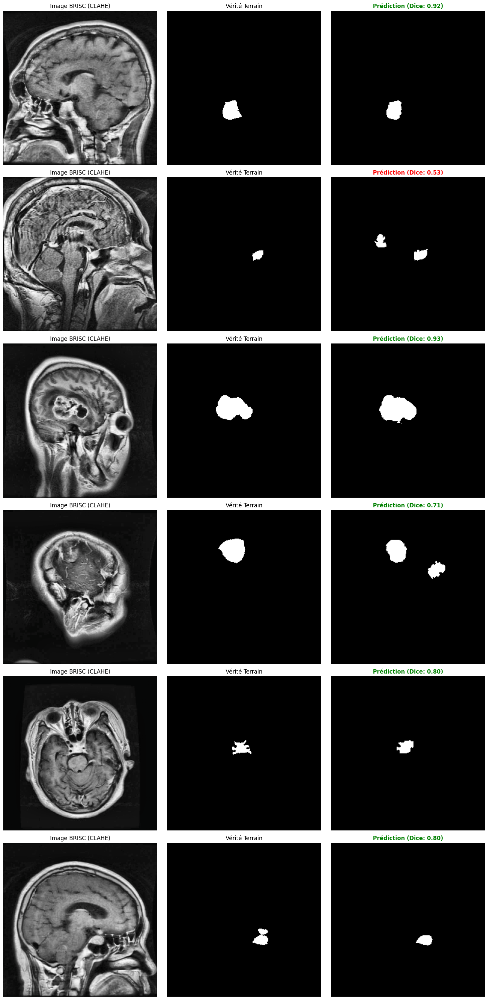

In [23]:
def visualize_training_results(model, generator, num_samples=5):
    # --- CHANGEMENT CLÉ : Sélection d'un BATCH ALÉATOIRE ---

    # 1. Déterminer le nombre total de batches disponibles
    num_batches = len(generator)
    if num_batches == 0:
        print("Erreur: Le générateur ne contient aucun batch.")
        return

    # 2. Choisir un index de batch aléatoire
    random_batch_index = random.randint(0, num_batches - 1)

    # 3. Récupérer le batch complet à cet index aléatoire
    X_batch, y_batch = generator[random_batch_index]

    # 4. Faire les prédictions (sur ce batch aléatoire)
    print(f"🔮 Génération des prédictions pour le batch d'index {random_batch_index}...")
    preds = model.predict(X_batch, verbose=0)

    # 5. Binariser (0 ou 1)
    preds_binary = (preds > 0.5).astype(np.float32)

    # --- Affichage (inchangé) ---

    # On limite à 'num_samples' images
    n = min(num_samples, len(X_batch))

    plt.figure(figsize=(15, 5 * n))

    for i in range(n):
        # --- Colonne 1 : Image Originale ---
        plt.subplot(n, 3, i*3 + 1)
        img_rgb = X_batch[i][..., ::-1] # BGR -> RGB
        plt.imshow(img_rgb)
        plt.title("Image BRISC (CLAHE)")
        plt.axis('off')

        # --- Colonne 2 : Vérité Terrain ---
        plt.subplot(n, 3, i*3 + 2)
        plt.imshow(y_batch[i].squeeze(), cmap='gray')
        plt.title("Vérité Terrain")
        plt.axis('off')

        # --- Colonne 3 : Prédiction du modèle ---
        plt.subplot(n, 3, i*3 + 3)

        # Calcul du Dice score
        intersection = np.sum(y_batch[i] * preds_binary[i])
        dice = (2. * intersection + 1) / (np.sum(y_batch[i]) + np.sum(preds_binary[i]) + 1)

        plt.imshow(preds_binary[i].squeeze(), cmap='gray', alpha=1.0)

        # Titre coloré
        col = 'green' if dice > 0.7 else 'red'
        plt.title(f"Prédiction (Dice: {dice:.2f})", color=col, fontweight='bold')
        plt.axis('off')

    plt.tight_layout()
    plt.show()

# Lancer la visualisation
# On utilise 'val_gen' qui est ton générateur de validation BRISC
visualize_training_results(model, val_gen, num_samples=6)

In [15]:
# Lancement de l'évaluation
print("📊 Calcul des scores sur le jeu de validation...")
results = model.evaluate(val_gen, verbose=1)

# Affichage propre des résultats
print("\n🏆 RÉSULTATS GLOBAUX :")
print(f"   📉 Loss (Perte)      : {results[0]:.4f}")
print(f"   🎯 Accuracy          : {results[1]:.4f}")
print(f"   🎲 Dice Coefficient  : {results[2]:.4f}")

📊 Calcul des scores sur le jeu de validation...
24/24 ━━━━━━━━━━━━━━━━━━━━ 10s 419ms/step - accuracy: 0.9943 - dice_coef: 0.8181 - loss: 0.1819

🏆 RÉSULTATS GLOBAUX :
   📉 Loss (Perte)      : 0.1764
   🎯 Accuracy          : 0.9944
   🎲 Dice Coefficient  : 0.8236


## Entraînement du U-Net .tiff et ses poids sur les données jpg

In [16]:
# --- 1. RESET & CHARGEMENT DU TRANSFERT ---
K.clear_session()

# On réutilise la fonction déjà définie en mémoire
model_transfer = simple_unet_model(IMG_SIZE, IMG_SIZE, 3)

# Chemin vers ton ancien modèle TIFF (Assure-toi qu'il est bien dans les fichiers Colab)
POIDS_TIFF = '/content/u-net_final_best.h5'

print(f"🔄 Injection des connaissances TIFF depuis {POIDS_TIFF}...")
try:
    model_transfer.load_weights(POIDS_TIFF)
    print("✅ Poids chargés ! Le modèle est prêt pour le Fine-Tuning.")
except Exception as e:
    print(f"❌ Erreur critique : {e}")
    print("Arrêt recommandé : vérifie le nom du fichier .h5")

# --- 2. COMPILATION DOUCE (Learning Rate réduit) ---
# On passe à 1e-4 (0.0001) pour affiner doucement les poids existants
model_transfer.compile(optimizer=Adam(learning_rate=1e-4),
              loss=dice_coef_loss,
              metrics=['accuracy', dice_coef])

# --- 3. CALLBACKS (Nouveau nom de fichier) ---
callbacks_transfer = [
    tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True, verbose=1),
    tf.keras.callbacks.ReduceLROnPlateau(monitor='val_loss', factor=0.2, patience=5, min_lr=1e-7, verbose=1),

    # IMPORTANT : On sauvegarde sous un nom différent ('brisc_transfer_best.h5')
    # pour pouvoir comparer avec le modèle 'from scratch' ('brisc_unet_best.h5')
    tf.keras.callbacks.ModelCheckpoint('brisc_transfer_best.h5', monitor='val_dice_coef', save_best_only=True, mode='max', verbose=1)
]

# --- 4. ENTRAÎNEMENT ---
# On réutilise directement train_gen et val_gen qui sont déjà en mémoire
print("🚀 Lancement du Transfert Learning (Fine-Tuning)...")
history_transfer = model_transfer.fit(
    train_gen,
    validation_data=val_gen,
    epochs=50,
    callbacks=callbacks_transfer
)

🔄 Injection des connaissances TIFF depuis /content/u-net_final_best.h5...
✅ Poids chargés ! Le modèle est prêt pour le Fine-Tuning.
🚀 Lancement du Transfert Learning (Fine-Tuning)...
Epoch 1/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 311ms/step - accuracy: 0.9857 - dice_coef: 0.4192 - loss: 0.5808
Epoch 1: val_dice_coef improved from -inf to 0.52385, saving model to brisc_transfer_best.h5


98/98 ━━━━━━━━━━━━━━━━━━━━ 55s 406ms/step - accuracy: 0.9857 - dice_coef: 0.4198 - loss: 0.5802 - val_accuracy: 0.9846 - val_dice_coef: 0.5238 - val_loss: 0.4762 - learning_rate: 1.0000e-04
Epoch 2/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 325ms/step - accuracy: 0.9881 - dice_coef: 0.5664 - loss: 0.4336
Epoch 2: val_dice_coef improved from 0.52385 to 0.56994, saving model to brisc_transfer_best.h5


98/98 ━━━━━━━━━━━━━━━━━━━━ 39s 394ms/step - accuracy: 0.9881 - dice_coef: 0.5665 - loss: 0.4335 - val_accuracy: 0.9864 - val_dice_coef: 0.5699 - val_loss: 0.4301 - learning_rate: 1.0000e-04
Epoch 3/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 323ms/step - accuracy: 0.9892 - dice_coef: 0.6178 - loss: 0.3822
Epoch 3: val_dice_coef improved from 0.56994 to 0.61402, saving model to brisc_transfer_best.h5


98/98 ━━━━━━━━━━━━━━━━━━━━ 39s 393ms/step - accuracy: 0.9892 - dice_coef: 0.6178 - loss: 0.3822 - val_accuracy: 0.9885 - val_dice_coef: 0.6140 - val_loss: 0.3860 - learning_rate: 1.0000e-04
Epoch 4/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 323ms/step - accuracy: 0.9895 - dice_coef: 0.6387 - loss: 0.3613
Epoch 4: val_dice_coef improved from 0.61402 to 0.62925, saving model to brisc_transfer_best.h5


98/98 ━━━━━━━━━━━━━━━━━━━━ 42s 431ms/step - accuracy: 0.9895 - dice_coef: 0.6387 - loss: 0.3613 - val_accuracy: 0.9890 - val_dice_coef: 0.6293 - val_loss: 0.3707 - learning_rate: 1.0000e-04
Epoch 5/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 311ms/step - accuracy: 0.9905 - dice_coef: 0.6651 - loss: 0.3349
Epoch 5: val_dice_coef improved from 0.62925 to 0.64692, saving model to brisc_transfer_best.h5


98/98 ━━━━━━━━━━━━━━━━━━━━ 38s 390ms/step - accuracy: 0.9905 - dice_coef: 0.6650 - loss: 0.3350 - val_accuracy: 0.9895 - val_dice_coef: 0.6469 - val_loss: 0.3531 - learning_rate: 1.0000e-04
Epoch 6/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step - accuracy: 0.9905 - dice_coef: 0.6610 - loss: 0.3390
Epoch 6: val_dice_coef improved from 0.64692 to 0.66359, saving model to brisc_transfer_best.h5


98/98 ━━━━━━━━━━━━━━━━━━━━ 39s 396ms/step - accuracy: 0.9905 - dice_coef: 0.6611 - loss: 0.3389 - val_accuracy: 0.9900 - val_dice_coef: 0.6636 - val_loss: 0.3364 - learning_rate: 1.0000e-04
Epoch 7/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step - accuracy: 0.9911 - dice_coef: 0.6880 - loss: 0.3120
Epoch 7: val_dice_coef improved from 0.66359 to 0.66367, saving model to brisc_transfer_best.h5


98/98 ━━━━━━━━━━━━━━━━━━━━ 38s 388ms/step - accuracy: 0.9911 - dice_coef: 0.6880 - loss: 0.3120 - val_accuracy: 0.9898 - val_dice_coef: 0.6637 - val_loss: 0.3363 - learning_rate: 1.0000e-04
Epoch 8/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step - accuracy: 0.9913 - dice_coef: 0.7012 - loss: 0.2988
Epoch 8: val_dice_coef did not improve from 0.66367
98/98 ━━━━━━━━━━━━━━━━━━━━ 38s 386ms/step - accuracy: 0.9913 - dice_coef: 0.7012 - loss: 0.2988 - val_accuracy: 0.9893 - val_dice_coef: 0.6588 - val_loss: 0.3412 - learning_rate: 1.0000e-04
Epoch 9/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 322ms/step - accuracy: 0.9915 - dice_coef: 0.7044 - loss: 0.2956
Epoch 9: val_dice_coef improved from 0.66367 to 0.67365, saving model to brisc_transfer_best.h5


98/98 ━━━━━━━━━━━━━━━━━━━━ 39s 392ms/step - accuracy: 0.9915 - dice_coef: 0.7045 - loss: 0.2955 - val_accuracy: 0.9899 - val_dice_coef: 0.6737 - val_loss: 0.3263 - learning_rate: 1.0000e-04
Epoch 10/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 324ms/step - accuracy: 0.9917 - dice_coef: 0.7112 - loss: 0.2888
Epoch 10: val_dice_coef improved from 0.67365 to 0.69398, saving model to brisc_transfer_best.h5


98/98 ━━━━━━━━━━━━━━━━━━━━ 39s 399ms/step - accuracy: 0.9917 - dice_coef: 0.7112 - loss: 0.2888 - val_accuracy: 0.9907 - val_dice_coef: 0.6940 - val_loss: 0.3060 - learning_rate: 1.0000e-04
Epoch 11/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 312ms/step - accuracy: 0.9918 - dice_coef: 0.7070 - loss: 0.2930
Epoch 11: val_dice_coef did not improve from 0.69398
98/98 ━━━━━━━━━━━━━━━━━━━━ 40s 391ms/step - accuracy: 0.9918 - dice_coef: 0.7071 - loss: 0.2929 - val_accuracy: 0.9903 - val_dice_coef: 0.6853 - val_loss: 0.3147 - learning_rate: 1.0000e-04
Epoch 12/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step - accuracy: 0.9917 - dice_coef: 0.7329 - loss: 0.2671
Epoch 12: val_dice_coef improved from 0.69398 to 0.70126, saving model to brisc_transfer_best.h5


98/98 ━━━━━━━━━━━━━━━━━━━━ 39s 398ms/step - accuracy: 0.9917 - dice_coef: 0.7328 - loss: 0.2672 - val_accuracy: 0.9910 - val_dice_coef: 0.7013 - val_loss: 0.2987 - learning_rate: 1.0000e-04
Epoch 13/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step - accuracy: 0.9920 - dice_coef: 0.7281 - loss: 0.2719
Epoch 13: val_dice_coef did not improve from 0.70126
98/98 ━━━━━━━━━━━━━━━━━━━━ 39s 393ms/step - accuracy: 0.9920 - dice_coef: 0.7281 - loss: 0.2719 - val_accuracy: 0.9908 - val_dice_coef: 0.6992 - val_loss: 0.3008 - learning_rate: 1.0000e-04
Epoch 14/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 325ms/step - accuracy: 0.9919 - dice_coef: 0.7227 - loss: 0.2773
Epoch 14: val_dice_coef improved from 0.70126 to 0.70681, saving model to brisc_transfer_best.h5


98/98 ━━━━━━━━━━━━━━━━━━━━ 39s 396ms/step - accuracy: 0.9919 - dice_coef: 0.7228 - loss: 0.2772 - val_accuracy: 0.9910 - val_dice_coef: 0.7068 - val_loss: 0.2932 - learning_rate: 1.0000e-04
Epoch 15/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 323ms/step - accuracy: 0.9918 - dice_coef: 0.7175 - loss: 0.2825
Epoch 15: val_dice_coef did not improve from 0.70681
98/98 ━━━━━━━━━━━━━━━━━━━━ 39s 392ms/step - accuracy: 0.9918 - dice_coef: 0.7177 - loss: 0.2823 - val_accuracy: 0.9907 - val_dice_coef: 0.7067 - val_loss: 0.2933 - learning_rate: 1.0000e-04
Epoch 16/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step - accuracy: 0.9922 - dice_coef: 0.7356 - loss: 0.2644
Epoch 16: val_dice_coef did not improve from 0.70681
98/98 ━━━━━━━━━━━━━━━━━━━━ 42s 423ms/step - accuracy: 0.9922 - dice_coef: 0.7356 - loss: 0.2644 - val_accuracy: 0.9911 - val_dice_coef: 0.7066 - val_loss: 0.2934 - learning_rate: 1.0000e-04
Epoch 17/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 313ms/step - accuracy: 0.9924 - dice_coef: 0.7338 - loss: 0.2662
Epo

98/98 ━━━━━━━━━━━━━━━━━━━━ 39s 391ms/step - accuracy: 0.9924 - dice_coef: 0.7339 - loss: 0.2661 - val_accuracy: 0.9915 - val_dice_coef: 0.7225 - val_loss: 0.2775 - learning_rate: 1.0000e-04
Epoch 18/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 326ms/step - accuracy: 0.9927 - dice_coef: 0.7474 - loss: 0.2526
Epoch 18: val_dice_coef did not improve from 0.72252
98/98 ━━━━━━━━━━━━━━━━━━━━ 39s 396ms/step - accuracy: 0.9927 - dice_coef: 0.7474 - loss: 0.2526 - val_accuracy: 0.9912 - val_dice_coef: 0.7195 - val_loss: 0.2805 - learning_rate: 1.0000e-04
Epoch 19/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step - accuracy: 0.9924 - dice_coef: 0.7462 - loss: 0.2538
Epoch 19: val_dice_coef improved from 0.72252 to 0.72734, saving model to brisc_transfer_best.h5


98/98 ━━━━━━━━━━━━━━━━━━━━ 38s 387ms/step - accuracy: 0.9924 - dice_coef: 0.7462 - loss: 0.2538 - val_accuracy: 0.9918 - val_dice_coef: 0.7273 - val_loss: 0.2727 - learning_rate: 1.0000e-04
Epoch 20/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step - accuracy: 0.9930 - dice_coef: 0.7600 - loss: 0.2400
Epoch 20: val_dice_coef did not improve from 0.72734
98/98 ━━━━━━━━━━━━━━━━━━━━ 38s 387ms/step - accuracy: 0.9930 - dice_coef: 0.7599 - loss: 0.2401 - val_accuracy: 0.9913 - val_dice_coef: 0.7161 - val_loss: 0.2839 - learning_rate: 1.0000e-04
Epoch 21/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 321ms/step - accuracy: 0.9931 - dice_coef: 0.7640 - loss: 0.2360
Epoch 21: val_dice_coef did not improve from 0.72734
98/98 ━━━━━━━━━━━━━━━━━━━━ 38s 390ms/step - accuracy: 0.9931 - dice_coef: 0.7640 - loss: 0.2360 - val_accuracy: 0.9915 - val_dice_coef: 0.7259 - val_loss: 0.2741 - learning_rate: 1.0000e-04
Epoch 22/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 327ms/step - accuracy: 0.9929 - dice_coef: 0.7515 - loss: 0.2485
Epo

98/98 ━━━━━━━━━━━━━━━━━━━━ 40s 405ms/step - accuracy: 0.9929 - dice_coef: 0.7516 - loss: 0.2484 - val_accuracy: 0.9918 - val_dice_coef: 0.7349 - val_loss: 0.2651 - learning_rate: 1.0000e-04
Epoch 23/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step - accuracy: 0.9930 - dice_coef: 0.7599 - loss: 0.2401
Epoch 23: val_dice_coef did not improve from 0.73489
98/98 ━━━━━━━━━━━━━━━━━━━━ 39s 392ms/step - accuracy: 0.9930 - dice_coef: 0.7599 - loss: 0.2401 - val_accuracy: 0.9920 - val_dice_coef: 0.7302 - val_loss: 0.2698 - learning_rate: 1.0000e-04
Epoch 24/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 310ms/step - accuracy: 0.9933 - dice_coef: 0.7691 - loss: 0.2309
Epoch 24: val_dice_coef did not improve from 0.73489
98/98 ━━━━━━━━━━━━━━━━━━━━ 38s 388ms/step - accuracy: 0.9933 - dice_coef: 0.7691 - loss: 0.2309 - val_accuracy: 0.9921 - val_dice_coef: 0.7340 - val_loss: 0.2660 - learning_rate: 1.0000e-04
Epoch 25/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 311ms/step - accuracy: 0.9930 - dice_coef: 0.7615 - loss: 0.2385
Epo

98/98 ━━━━━━━━━━━━━━━━━━━━ 38s 390ms/step - accuracy: 0.9930 - dice_coef: 0.7616 - loss: 0.2384 - val_accuracy: 0.9919 - val_dice_coef: 0.7372 - val_loss: 0.2628 - learning_rate: 1.0000e-04
Epoch 26/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step - accuracy: 0.9932 - dice_coef: 0.7736 - loss: 0.2264
Epoch 26: val_dice_coef did not improve from 0.73723
98/98 ━━━━━━━━━━━━━━━━━━━━ 39s 391ms/step - accuracy: 0.9932 - dice_coef: 0.7736 - loss: 0.2264 - val_accuracy: 0.9916 - val_dice_coef: 0.7330 - val_loss: 0.2670 - learning_rate: 1.0000e-04
Epoch 27/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step - accuracy: 0.9934 - dice_coef: 0.7764 - loss: 0.2236
Epoch 27: val_dice_coef did not improve from 0.73723
98/98 ━━━━━━━━━━━━━━━━━━━━ 38s 389ms/step - accuracy: 0.9934 - dice_coef: 0.7763 - loss: 0.2237 - val_accuracy: 0.9919 - val_dice_coef: 0.7363 - val_loss: 0.2637 - learning_rate: 1.0000e-04
Epoch 28/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step - accuracy: 0.9936 - dice_coef: 0.7843 - loss: 0.2157
Epo

98/98 ━━━━━━━━━━━━━━━━━━━━ 38s 389ms/step - accuracy: 0.9936 - dice_coef: 0.7842 - loss: 0.2158 - val_accuracy: 0.9920 - val_dice_coef: 0.7402 - val_loss: 0.2598 - learning_rate: 1.0000e-04
Epoch 29/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step - accuracy: 0.9939 - dice_coef: 0.7939 - loss: 0.2061
Epoch 29: val_dice_coef did not improve from 0.74024
98/98 ━━━━━━━━━━━━━━━━━━━━ 38s 385ms/step - accuracy: 0.9939 - dice_coef: 0.7937 - loss: 0.2063 - val_accuracy: 0.9918 - val_dice_coef: 0.7370 - val_loss: 0.2630 - learning_rate: 1.0000e-04
Epoch 30/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step - accuracy: 0.9936 - dice_coef: 0.7793 - loss: 0.2207
Epoch 30: val_dice_coef improved from 0.74024 to 0.74606, saving model to brisc_transfer_best.h5


98/98 ━━━━━━━━━━━━━━━━━━━━ 38s 390ms/step - accuracy: 0.9936 - dice_coef: 0.7793 - loss: 0.2207 - val_accuracy: 0.9923 - val_dice_coef: 0.7461 - val_loss: 0.2539 - learning_rate: 1.0000e-04
Epoch 31/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 320ms/step - accuracy: 0.9936 - dice_coef: 0.7795 - loss: 0.2205
Epoch 31: val_dice_coef improved from 0.74606 to 0.74784, saving model to brisc_transfer_best.h5


98/98 ━━━━━━━━━━━━━━━━━━━━ 39s 398ms/step - accuracy: 0.9936 - dice_coef: 0.7796 - loss: 0.2204 - val_accuracy: 0.9922 - val_dice_coef: 0.7478 - val_loss: 0.2522 - learning_rate: 1.0000e-04
Epoch 32/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 312ms/step - accuracy: 0.9936 - dice_coef: 0.7762 - loss: 0.2238
Epoch 32: val_dice_coef improved from 0.74784 to 0.75482, saving model to brisc_transfer_best.h5


98/98 ━━━━━━━━━━━━━━━━━━━━ 38s 389ms/step - accuracy: 0.9936 - dice_coef: 0.7762 - loss: 0.2238 - val_accuracy: 0.9924 - val_dice_coef: 0.7548 - val_loss: 0.2452 - learning_rate: 1.0000e-04
Epoch 33/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 311ms/step - accuracy: 0.9934 - dice_coef: 0.7760 - loss: 0.2240
Epoch 33: val_dice_coef did not improve from 0.75482
98/98 ━━━━━━━━━━━━━━━━━━━━ 38s 388ms/step - accuracy: 0.9934 - dice_coef: 0.7761 - loss: 0.2239 - val_accuracy: 0.9922 - val_dice_coef: 0.7498 - val_loss: 0.2502 - learning_rate: 1.0000e-04
Epoch 34/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 321ms/step - accuracy: 0.9935 - dice_coef: 0.7828 - loss: 0.2172
Epoch 34: val_dice_coef improved from 0.75482 to 0.75546, saving model to brisc_transfer_best.h5


98/98 ━━━━━━━━━━━━━━━━━━━━ 39s 399ms/step - accuracy: 0.9935 - dice_coef: 0.7829 - loss: 0.2171 - val_accuracy: 0.9926 - val_dice_coef: 0.7555 - val_loss: 0.2445 - learning_rate: 1.0000e-04
Epoch 35/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 313ms/step - accuracy: 0.9936 - dice_coef: 0.7880 - loss: 0.2120
Epoch 35: val_dice_coef did not improve from 0.75546
98/98 ━━━━━━━━━━━━━━━━━━━━ 38s 385ms/step - accuracy: 0.9936 - dice_coef: 0.7880 - loss: 0.2120 - val_accuracy: 0.9921 - val_dice_coef: 0.7447 - val_loss: 0.2553 - learning_rate: 1.0000e-04
Epoch 36/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step - accuracy: 0.9940 - dice_coef: 0.7981 - loss: 0.2019
Epoch 36: val_dice_coef improved from 0.75546 to 0.75783, saving model to brisc_transfer_best.h5


98/98 ━━━━━━━━━━━━━━━━━━━━ 38s 385ms/step - accuracy: 0.9940 - dice_coef: 0.7980 - loss: 0.2020 - val_accuracy: 0.9927 - val_dice_coef: 0.7578 - val_loss: 0.2422 - learning_rate: 1.0000e-04
Epoch 37/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step - accuracy: 0.9941 - dice_coef: 0.8026 - loss: 0.1974
Epoch 37: val_dice_coef did not improve from 0.75783
98/98 ━━━━━━━━━━━━━━━━━━━━ 38s 384ms/step - accuracy: 0.9941 - dice_coef: 0.8026 - loss: 0.1974 - val_accuracy: 0.9922 - val_dice_coef: 0.7523 - val_loss: 0.2477 - learning_rate: 1.0000e-04
Epoch 38/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 321ms/step - accuracy: 0.9941 - dice_coef: 0.8016 - loss: 0.1984
Epoch 38: val_dice_coef did not improve from 0.75783
98/98 ━━━━━━━━━━━━━━━━━━━━ 38s 390ms/step - accuracy: 0.9941 - dice_coef: 0.8016 - loss: 0.1984 - val_accuracy: 0.9922 - val_dice_coef: 0.7512 - val_loss: 0.2488 - learning_rate: 1.0000e-04
Epoch 39/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 321ms/step - accuracy: 0.9938 - dice_coef: 0.7928 - loss: 0.2072
Epo

98/98 ━━━━━━━━━━━━━━━━━━━━ 39s 391ms/step - accuracy: 0.9939 - dice_coef: 0.8044 - loss: 0.1956 - val_accuracy: 0.9926 - val_dice_coef: 0.7585 - val_loss: 0.2415 - learning_rate: 1.0000e-04
Epoch 41/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step - accuracy: 0.9938 - dice_coef: 0.7952 - loss: 0.2048
Epoch 41: val_dice_coef did not improve from 0.75847
98/98 ━━━━━━━━━━━━━━━━━━━━ 38s 387ms/step - accuracy: 0.9938 - dice_coef: 0.7952 - loss: 0.2048 - val_accuracy: 0.9924 - val_dice_coef: 0.7567 - val_loss: 0.2433 - learning_rate: 1.0000e-04
Epoch 42/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step - accuracy: 0.9939 - dice_coef: 0.8027 - loss: 0.1973
Epoch 42: val_dice_coef improved from 0.75847 to 0.75969, saving model to brisc_transfer_best.h5


98/98 ━━━━━━━━━━━━━━━━━━━━ 39s 391ms/step - accuracy: 0.9939 - dice_coef: 0.8027 - loss: 0.1973 - val_accuracy: 0.9928 - val_dice_coef: 0.7597 - val_loss: 0.2403 - learning_rate: 1.0000e-04
Epoch 43/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 311ms/step - accuracy: 0.9943 - dice_coef: 0.8094 - loss: 0.1906
Epoch 43: val_dice_coef improved from 0.75969 to 0.76672, saving model to brisc_transfer_best.h5


98/98 ━━━━━━━━━━━━━━━━━━━━ 38s 389ms/step - accuracy: 0.9943 - dice_coef: 0.8093 - loss: 0.1907 - val_accuracy: 0.9927 - val_dice_coef: 0.7667 - val_loss: 0.2333 - learning_rate: 1.0000e-04
Epoch 44/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 310ms/step - accuracy: 0.9939 - dice_coef: 0.7965 - loss: 0.2035
Epoch 44: val_dice_coef did not improve from 0.76672
98/98 ━━━━━━━━━━━━━━━━━━━━ 38s 386ms/step - accuracy: 0.9939 - dice_coef: 0.7966 - loss: 0.2034 - val_accuracy: 0.9927 - val_dice_coef: 0.7648 - val_loss: 0.2352 - learning_rate: 1.0000e-04
Epoch 45/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step - accuracy: 0.9941 - dice_coef: 0.8075 - loss: 0.1925
Epoch 45: val_dice_coef did not improve from 0.76672
98/98 ━━━━━━━━━━━━━━━━━━━━ 38s 383ms/step - accuracy: 0.9941 - dice_coef: 0.8075 - loss: 0.1925 - val_accuracy: 0.9924 - val_dice_coef: 0.7589 - val_loss: 0.2411 - learning_rate: 1.0000e-04
Epoch 46/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 326ms/step - accuracy: 0.9946 - dice_coef: 0.8171 - loss: 0.1829
Epo

98/98 ━━━━━━━━━━━━━━━━━━━━ 38s 388ms/step - accuracy: 0.9945 - dice_coef: 0.8163 - loss: 0.1837 - val_accuracy: 0.9926 - val_dice_coef: 0.7680 - val_loss: 0.2320 - learning_rate: 1.0000e-04
Epoch 48/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 319ms/step - accuracy: 0.9942 - dice_coef: 0.8138 - loss: 0.1862
Epoch 48: val_dice_coef did not improve from 0.76798
98/98 ━━━━━━━━━━━━━━━━━━━━ 38s 388ms/step - accuracy: 0.9942 - dice_coef: 0.8138 - loss: 0.1862 - val_accuracy: 0.9926 - val_dice_coef: 0.7660 - val_loss: 0.2340 - learning_rate: 1.0000e-04
Epoch 49/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step - accuracy: 0.9944 - dice_coef: 0.8195 - loss: 0.1805
Epoch 49: val_dice_coef improved from 0.76798 to 0.77047, saving model to brisc_transfer_best.h5


98/98 ━━━━━━━━━━━━━━━━━━━━ 38s 388ms/step - accuracy: 0.9944 - dice_coef: 0.8195 - loss: 0.1805 - val_accuracy: 0.9927 - val_dice_coef: 0.7705 - val_loss: 0.2295 - learning_rate: 1.0000e-04
Epoch 50/50
98/98 ━━━━━━━━━━━━━━━━━━━━ 0s 311ms/step - accuracy: 0.9941 - dice_coef: 0.8090 - loss: 0.1910
Epoch 50: val_dice_coef did not improve from 0.77047
98/98 ━━━━━━━━━━━━━━━━━━━━ 41s 388ms/step - accuracy: 0.9941 - dice_coef: 0.8091 - loss: 0.1909 - val_accuracy: 0.9928 - val_dice_coef: 0.7696 - val_loss: 0.2304 - learning_rate: 1.0000e-04
Restoring model weights from the end of the best epoch: 49.


In [17]:
# Ici, nous allons simplement évaluer sur le modèle en mémoire (qui a déjà les meilleurs poids restaurés)
print("📊 Évaluation du modèle de Transfert Learning sur le jeu de validation...")
results_transfer = model_transfer.evaluate(val_gen, verbose=1)

# Affichage des résultats pour le Transfert Learning
print("\n🏆 RÉSULTATS TRANSFERT LEARNING :")
print(f"   Dice Coefficient Final : {results_transfer[2]:.4f}")
print(f"   Loss Final             : {results_transfer[0]:.4f}")

📊 Évaluation du modèle de Transfert Learning sur le jeu de validation...
24/24 ━━━━━━━━━━━━━━━━━━━━ 8s 297ms/step - accuracy: 0.9926 - dice_coef: 0.7723 - loss: 0.2277

🏆 RÉSULTATS TRANSFERT LEARNING :
   Dice Coefficient Final : 0.7666
   Loss Final             : 0.2334


🔮 Génération des prédictions pour le batch d'index 3...


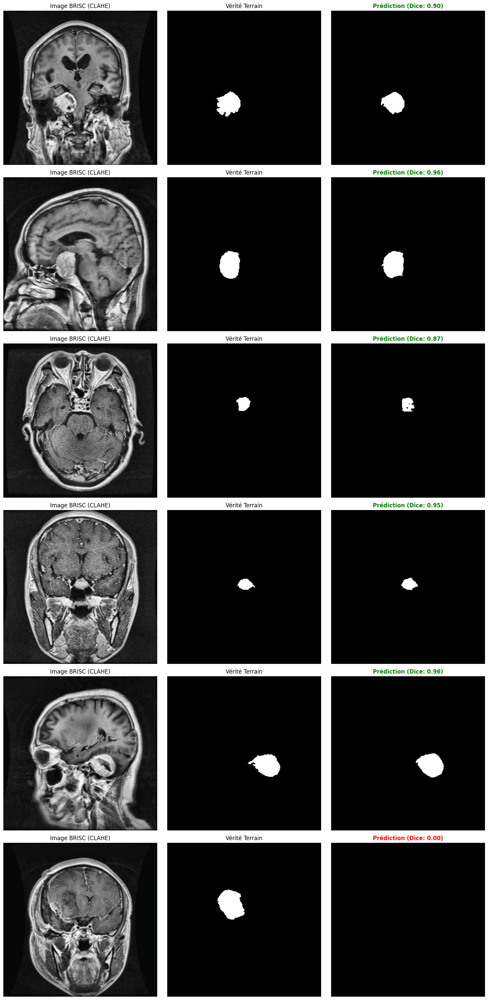

In [27]:
visualize_training_results(model_transfer, val_gen, num_samples=6)

## Identification images non performante

In [29]:
# --- DÉFINITIONS ET CHARGEMENT ---
# Assurez-vous que ces fonctions sont définies en mémoire (dice_coef et dice_coef_loss)
# (Si vous avez redémarré la session, exécutez la cellule de définition des métriques)

# On réutilise la même architecture U-Net (simple_unet_model) pour le chargement.

MODEL_TRANSFER_PATH = '/content/brisc_transfer_best.h5'
CRITICAL_THRESHOLD = 0.4

try:
    # On charge le meilleur modèle sauvegardé
    model_diagnostic = load_model(
        MODEL_TRANSFER_PATH,
        custom_objects={'dice_coef': dice_coef, 'dice_coef_loss': dice_coef_loss}
    )
    print("✅ Modèle de diagnostic chargé.")
except Exception as e:
    print(f"❌ Erreur de chargement : {e}")
    # Vous pouvez décommanter les lignes ci-dessous si vous n'arrivez pas à charger le modèle complet :
    model_diagnostic = simple_unet_model(IMG_SIZE, IMG_SIZE, 3)
    model_diagnostic.load_weights(MODEL_TRANSFER_PATH)
    print("✅ Poids chargés (Méthode load_weights).")

# --- INITIALISATION DE LA BOUCLE ---
critical_failures = []
all_dice_scores = []
num_batches = len(val_gen)
batch_size = val_gen.batch_size
all_val_paths = val_gen.image_paths # Les chemins des fichiers sont stockés ici

print(f"\n🔍 Démarrage de l'analyse des {len(all_val_paths)} images de validation...")

for b in range(num_batches):
    # Récupérer les données du batch
    X_batch, y_batch = val_gen[b]

    # Récupérer la tranche de chemins correspondante pour ce batch
    # On calcule la bonne tranche dans la liste globale des chemins de validation
    path_slice = all_val_paths[b * batch_size : (b + 1) * batch_size]

    # Prédiction
    preds = model_diagnostic.predict(X_batch, verbose=0)
    preds_binary = (preds > 0.5).astype(np.float32)

    # Itération sur chaque image du batch
    for i in range(len(X_batch)):
        y_true = y_batch[i]
        y_pred = preds_binary[i]
        filename = os.path.basename(path_slice[i])

        # Calcul du Dice sur l'image individuelle (y_true et y_pred sont [256, 256, 1])
        intersection = np.sum(y_true * y_pred)
        dice = (2. * intersection + 1) / (np.sum(y_true) + np.sum(y_pred) + 1)

        all_dice_scores.append(dice)

        # --- TEST DU SEUIL CRITIQUE ---
        if dice < CRITICAL_THRESHOLD:
            critical_failures.append({'filename': filename, 'dice': dice})
            print(f"    ECHEC CRITIQUE : {filename} - Dice: {dice:.2f}")

# --- RÉSULTAT FINAL ---
if critical_failures:
    print(f"\n🚨 {len(critical_failures)} ÉCHECS CRITIQUES trouvés (Dice < {CRITICAL_THRESHOLD}).")
    print("Ces images doivent être inspectées visuellement pour identifier le Domain Shift.")
else:
    print("\n✅ Aucune image trouvée sous le seuil critique. Le modèle est très stable.")

print(f"🎲 Dice Score Moyen sur l'ensemble de la validation : {np.mean(all_dice_scores):.4f}")

❌ Erreur de chargement : name 'load_model' is not defined
✅ Poids chargés (Méthode load_weights).

🔍 Démarrage de l'analyse des 787 images de validation...
    ECHEC CRITIQUE : brisc2025_train_02064_me_sa_t1.jpg - Dice: 0.33
    ECHEC CRITIQUE : brisc2025_train_00015_gl_ax_t1.jpg - Dice: 0.00
    ECHEC CRITIQUE : brisc2025_train_00722_gl_co_t1.jpg - Dice: 0.00
    ECHEC CRITIQUE : brisc2025_train_00167_gl_ax_t1.jpg - Dice: 0.13
    ECHEC CRITIQUE : brisc2025_train_04244_pi_co_t1.jpg - Dice: 0.03
    ECHEC CRITIQUE : brisc2025_train_04442_pi_co_t1.jpg - Dice: 0.29
    ECHEC CRITIQUE : brisc2025_train_01780_me_co_t1.jpg - Dice: 0.00
    ECHEC CRITIQUE : brisc2025_train_00033_gl_ax_t1.jpg - Dice: 0.07
    ECHEC CRITIQUE : brisc2025_train_01654_me_co_t1.jpg - Dice: 0.00
    ECHEC CRITIQUE : brisc2025_train_01314_me_ax_t1.jpg - Dice: 0.22
    ECHEC CRITIQUE : brisc2025_train_01007_gl_sa_t1.jpg - Dice: 0.15
    ECHEC CRITIQUE : brisc2025_train_02393_me_sa_t1.jpg - Dice: 0.00
    ECHEC CRITIQ

In [39]:
# --- CONFIGURATION (Assurez-vous que ces variables existent en mémoire) ---
# Le chemin vers votre meilleur modèle de Transfert Learning
MODEL_TRANSFER_PATH = 'brisc_transfer_best.h5'
# Le seuil que vous avez fixé pour un échec critique
CRITICAL_THRESHOLD = 0.4
# Assurez-vous que la variable 'train_mask_dir' est toujours correcte (ex: 'brisc_data/segmentation_task/train/masks')
# Assurez-vous que 'all_val_paths' (la liste des chemins JPG de validation) est en mémoire
# Assurez-vous que 'model_transfer' ou 'model_diagnostic' n'est pas utilisé directement avant ce bloc pour éviter les conflits.


# --- 1. FONCTIONS ET CHARGEMENT ---

# A. Chargement du Modèle (Utilisation du nom du modèle qui est en mémoire)
try:
    # On utilise load_model pour s'assurer d'avoir le modèle qui a obtenu le meilleur score (ModelCheckpoint)
    model_diagnostic = load_model(
        MODEL_TRANSFER_PATH,
        custom_objects={'dice_coef': dice_coef, 'dice_coef_loss': dice_coef_loss}
    )
    print("✅ Modèle de diagnostic chargé (Meilleurs poids).")
except Exception as e:
    print(f"❌ Erreur lors du chargement de {MODEL_TRANSFER_PATH}. Assurez-vous que le fichier est présent et que les fonctions de métriques sont définies.")
    # Si le chargement échoue, le reste du script s'arrête.
    raise


# B. Fonction de Prétraitement pour une image individuelle (Doit correspondre au générateur)
def load_and_preprocess_single_image(image_path, img_size=256):
    clahe = cv2.createCLAHE(clipLimit=4.0, tileGridSize=(8,8))

    # 1. Traitement de l'Image (JPG)
    img = cv2.imread(image_path)
    if img is None: return None, None, None # Renvoie trois None pour la sécurité

    lab = cv2.cvtColor(img, cv2.COLOR_BGR2LAB)
    l, a, b = cv2.split(lab)
    l2 = clahe.apply(l)
    img_processed = cv2.cvtColor(cv2.merge((l2, a, b)), cv2.COLOR_LAB2BGR)
    img_processed = cv2.resize(img_processed, (img_size, img_size))
    img_normalized = img_processed / 255.0

    # 2. Traitement du Masque (PNG)
    filename = os.path.basename(image_path)
    mask_name = os.path.splitext(filename)[0] + ".png"
    mask_path = os.path.join(train_mask_dir, mask_name)

    mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)
    if mask is None: return None, None, None

    mask_resized = cv2.resize(mask, (img_size, img_size))
    mask_normalized = mask_resized / 255.0
    mask_binary = (mask_normalized > 0.5).astype(np.float32)

    # Renvoie l'image en format Keras (batch de taille 1) et le masque
    return np.expand_dims(img_normalized, axis=0), np.expand_dims(mask_binary, axis=-1), img_processed # Retourne aussi l'image pour un affichage plus flexible

# --- 2. ANALYSE ET FILTRAGE DES ÉCHECS ---

critical_failures_data = [] # Stocke les résultats (filename et dice)
all_dice_scores = []
num_batches = len(val_gen)
batch_size = val_gen.batch_size

print(f"\n🔍 Démarrage de l'analyse des {len(all_val_paths)} images de validation...")

for b in range(num_batches):
    # Récupération des données et des chemins du batch
    X_batch, y_batch = val_gen[b]
    path_slice = all_val_paths[b * batch_size : (b + 1) * batch_size]

    # Prédiction
    preds = model_diagnostic.predict(X_batch, verbose=0)
    preds_binary = (preds > 0.5).astype(np.float32)

    for i in range(len(X_batch)):
        y_true = y_batch[i]
        y_pred = preds_binary[i]
        filename = os.path.basename(path_slice[i])

        # Calcul du Dice sur l'image individuelle
        intersection = np.sum(y_true * y_pred)
        dice = (2. * intersection + 1) / (np.sum(y_true) + np.sum(y_pred) + 1)
        all_dice_scores.append(dice)

        # Test du seuil critique (Dice < 0.4)
        if dice < CRITICAL_THRESHOLD:
            critical_failures_data.append({'filename': filename, 'dice': dice})
            print(f"    ECHEC CRITIQUE : {filename} - Dice: {dice:.2f}")

mean_dice_validation = np.mean(all_dice_scores)
print(f"\n🎲 Dice Score Moyen Total : {mean_dice_validation:.4f}")


# --- 3. VISUALISATION DES PATTERNS D'ÉCHEC ---

if not critical_failures_data:
    print("\n✅ Aucune image à visualiser sous le seuil critique (Dice < 0.4).")
else:
    print(f"\n🧠 Affichage des {len(critical_failures_data)} cas d'échec critiques...")

    num_to_plot = len(critical_failures_data)
    plt.figure(figsize=(15, 5 * num_to_plot))

    # On récupère les chemins complets des images ayant échoué pour la visualisation
    failure_filenames = [f['filename'] for f in critical_failures_data]
    failure_paths_full = [p for p in all_val_paths if os.path.basename(p) in failure_filenames]

    for i, image_path in enumerate(failure_paths_full):
        # Récupération des données pour cette image
        X_single, y_true_single, img_display_bgr = load_and_preprocess_single_image(image_path, IMG_SIZE)

        if X_single is None: continue

        # Prédiction sur l'image individuelle
        pred = model_diagnostic.predict(X_single, verbose=0)
        pred_binary = (pred > 0.5).astype(np.float32)

        # Récupération du Dice score calculé précédemment
        dice_score = next((item['dice'] for item in critical_failures_data if item['filename'] == os.path.basename(image_path)), 0.0)

        # --- Affichage des 3 colonnes ---

        # Col 1: Image Originale (CLAHE)
        plt.subplot(num_to_plot, 3, i*3 + 1)
        plt.imshow(img_display_bgr[..., ::-1]) # BGR -> RGB pour l'affichage
        plt.title(f"Image ({os.path.basename(image_path)})", fontsize=10)
        plt.axis('off')

        # Col 2: Vérité Terrain
        plt.subplot(num_to_plot, 3, i*3 + 2)
        plt.imshow(y_true_single.squeeze(), cmap='gray')
        plt.title("Vérité Terrain", fontsize=10)
        plt.axis('off')

        # Col 3: Prédiction du Modèle (Fond noir / Tumeur blanche)
        plt.subplot(num_to_plot, 3, i*3 + 3)
        plt.imshow(pred_binary.squeeze(), cmap='gray')

        plt.title(f"Prédiction (Dice: {dice_score:.2f} 🚨)", color='red', fontweight='bold', fontsize=10)
        plt.axis('off')

    plt.tight_layout()
    plt.show()

# --- Conclusion ---
print("\nConclusion : Inspectez les images ci-dessus pour identifier un Domain Shift (Taille, Séquence, Bruit JPG).")

✅ Modèle de diagnostic chargé (Meilleurs poids).

🔍 Démarrage de l'analyse des 787 images de validation...
    ECHEC CRITIQUE : brisc2025_train_02064_me_sa_t1.jpg - Dice: 0.33
    ECHEC CRITIQUE : brisc2025_train_00015_gl_ax_t1.jpg - Dice: 0.00
    ECHEC CRITIQUE : brisc2025_train_00722_gl_co_t1.jpg - Dice: 0.00
    ECHEC CRITIQUE : brisc2025_train_00167_gl_ax_t1.jpg - Dice: 0.13
    ECHEC CRITIQUE : brisc2025_train_04244_pi_co_t1.jpg - Dice: 0.03
    ECHEC CRITIQUE : brisc2025_train_04442_pi_co_t1.jpg - Dice: 0.29
    ECHEC CRITIQUE : brisc2025_train_01780_me_co_t1.jpg - Dice: 0.00
    ECHEC CRITIQUE : brisc2025_train_00033_gl_ax_t1.jpg - Dice: 0.07
    ECHEC CRITIQUE : brisc2025_train_01654_me_co_t1.jpg - Dice: 0.00
    ECHEC CRITIQUE : brisc2025_train_01314_me_ax_t1.jpg - Dice: 0.22
    ECHEC CRITIQUE : brisc2025_train_01007_gl_sa_t1.jpg - Dice: 0.15
    ECHEC CRITIQUE : brisc2025_train_02393_me_sa_t1.jpg - Dice: 0.00
    ECHEC CRITIQUE : brisc2025_train_02149_me_sa_t1.jpg - Dice: 0

/tmp/ipython-input-2217176752.py:148: UserWarning: Glyph 128680 (\N{POLICE CARS REVOLVING LIGHT}) missing from font(s) DejaVu Sans.
  plt.tight_layout()
/usr/local/lib/python3.12/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 128680 (\N{POLICE CARS REVOLVING LIGHT}) missing from font(s) DejaVu Sans.
  fig.canvas.print_figure(bytes_io, **kw)



Conclusion : Inspectez les images ci-dessus pour identifier un Domain Shift (Taille, Séquence, Bruit JPG).


In [46]:
# --- CONFIGURATION ---
MODEL_TRANSFER_PATH = 'brisc_transfer_best.h5'
SUCCESS_THRESHOLD = 0.95  # Seuil de l'excellence
NUM_IMAGES_TO_SHOW = 5    # Nombre d'images à afficher

# --- 1. CHARGEMENT ET PRÉPARATION ---

# Chargement du modèle (si pas déjà fait)
try:
    if 'model_diagnostic' not in globals():
        model_diagnostic = load_model(
            MODEL_TRANSFER_PATH,
            custom_objects={'dice_coef': dice_coef, 'dice_coef_loss': dice_coef_loss}
        )
        print("✅ Modèle chargé.")
except:
    pass

# Fonction de prétraitement individuelle (Nécessaire pour recharger les images depuis la liste)
def load_and_preprocess_single_image(image_path, img_size=256):
    clahe = cv2.createCLAHE(clipLimit=4.0, tileGridSize=(8,8))

    # Image
    img = cv2.imread(image_path)
    if img is None: return None, None, None
    lab = cv2.cvtColor(img, cv2.COLOR_BGR2LAB)
    l, a, b = cv2.split(lab)
    l2 = clahe.apply(l)
    img_processed = cv2.cvtColor(cv2.merge((l2, a, b)), cv2.COLOR_LAB2BGR)
    img_resized = cv2.resize(img_processed, (img_size, img_size))
    img_normalized = img_resized / 255.0

    # Masque
    filename = os.path.basename(image_path)
    mask_name = os.path.splitext(filename)[0] + ".png"
    mask_path = os.path.join(train_mask_dir, mask_name) # train_mask_dir doit être défini

    mask = cv2.imread(mask_path, cv2.IMREAD_GRAYSCALE)
    if mask is None: return None, None, None
    mask_resized = cv2.resize(mask, (img_size, img_size))
    mask_normalized = mask_resized / 255.0
    mask_binary = (mask_normalized > 0.5).astype(np.float32)

    return np.expand_dims(img_normalized, axis=0), np.expand_dims(mask_binary, axis=-1), img_resized

# --- 2. RECHERCHE DES SUCCÈS (Dice >= 0.95) ---

success_data = []
all_val_paths = val_gen.image_paths

print(f"\n🔍 Recherche des images avec Dice >= {SUCCESS_THRESHOLD}...")

# On parcourt le générateur par batch pour aller vite
for b in range(len(val_gen)):
    X_batch, y_batch = val_gen[b]
    path_slice = all_val_paths[b * val_gen.batch_size : (b + 1) * val_gen.batch_size]

    preds = model_diagnostic.predict(X_batch, verbose=0)
    preds_binary = (preds > 0.5).astype(np.float32)

    for i in range(len(X_batch)):
        y_true = y_batch[i]
        y_pred = preds_binary[i]

        # Calcul Dice
        intersection = np.sum(y_true * y_pred)
        dice = (2. * intersection + 1) / (np.sum(y_true) + np.sum(y_pred) + 1)

        if dice >= SUCCESS_THRESHOLD:
            success_data.append({'filename': os.path.basename(path_slice[i]), 'dice': dice, 'path': path_slice[i]})

print(f"✅ Trouvé {len(success_data)} champions (Dice >= {SUCCESS_THRESHOLD}).")


🔍 Recherche des images avec Dice >= 0.95...
✅ Trouvé 143 champions (Dice >= 0.95).



🏆 Affichage de 5 succès aléatoires :


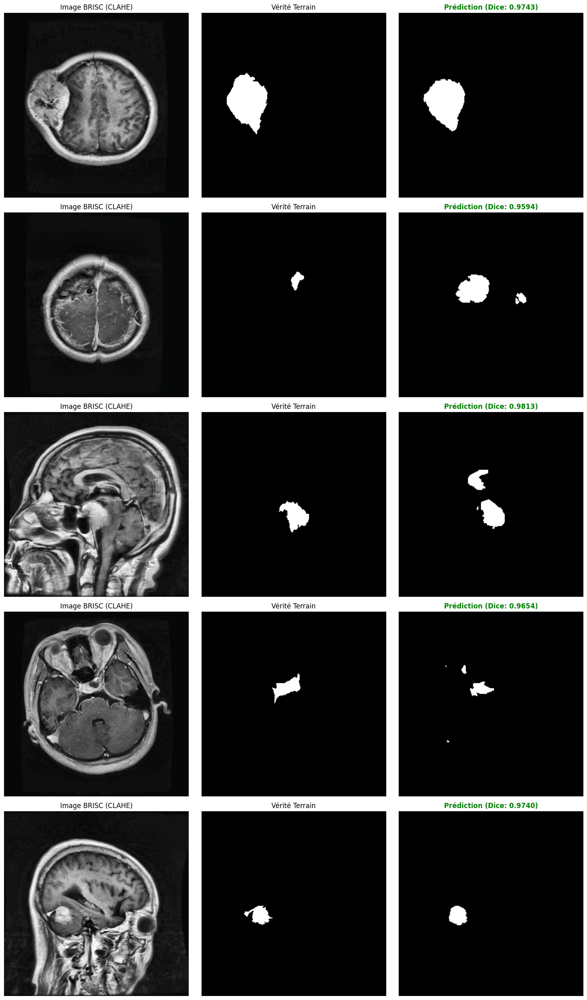

In [48]:
# --- 3. AFFICHAGE CLASSIQUE (Présentation Précédente) ---

if not success_data:
    print("❌ Aucune image trouvée avec ce score.")
else:
    # Sélection aléatoire
    num_to_plot = min(NUM_IMAGES_TO_SHOW, len(success_data))
    selected_successes = random.sample(success_data, num_to_plot)

    print(f"\n🏆 Affichage de {num_to_plot} succès aléatoires :")

    plt.figure(figsize=(15, 5 * num_to_plot))

    for i, item in enumerate(selected_successes):
        image_path = item['path']
        dice_score = item['dice']

        # Re-chargement pour affichage
        X_single, y_true_single, img_display_bgr = load_and_preprocess_single_image(image_path, 256)
        if X_single is None: continue

        pred = model_diagnostic.predict(X_single, verbose=0)
        pred_binary = (pred > 0.5).astype(np.float32)

        # --- Colonne 1 : Image ---
        plt.subplot(num_to_plot, 3, i*3 + 1)
        plt.imshow(img_display_bgr[..., ::-1]) # BGR -> RGB
        plt.title("Image BRISC (CLAHE)")
        plt.axis('off')

        # --- Colonne 2 : Vérité Terrain ---
        plt.subplot(num_to_plot, 3, i*3 + 2)
        plt.imshow(y_true_single.squeeze(), cmap='gray')
        plt.title("Vérité Terrain")
        plt.axis('off')

        # --- Colonne 3 : Prédiction (Titre Coloré ici) ---
        plt.subplot(num_to_plot, 3, i*3 + 3)
        plt.imshow(pred_binary.squeeze(), cmap='gray') # Fond noir, tumeur blanche

        # Le style que tu aimes : Score dans le titre de la 3ème colonne
        plt.title(f"Prédiction (Dice: {dice_score:.4f})", color='green', fontweight='bold')
        plt.axis('off')

    plt.tight_layout()
    plt.show()